In [1]:
# Python import
import os
import copy
import random
import collections
import itertools
import numpy as np
import pandas as pd
import lightgbm as lgb
import warnings
import joblib
from sklearn.model_selection import train_test_split,RandomizedSearchCV
import sklearn.metrics as metrics
from sklearn.linear_model import LogisticRegression
import matplotlib.pyplot as plt
from sklearn.impute import SimpleImputer
from sklearn.utils import resample
import lightgbm as lgb
from sklearn import svm
from sklearn.ensemble import RandomForestClassifier

In [2]:
def balance_dataset_by_tag(df, tag_column='tag', random_state=42):
    """
    df : pd.DataFrame
        需要处理的原始数据集。
    tag_column : str, 默认 'tag'
        用于分割数据的列名，默认是 'tag'。
    random_state : int, 默认 42
    返回:
    pd.DataFrame
        平衡后的数据集，tag列为0和1的行数一致。
    """
    # 分割数据集为 tag=0 和 tag=1 的两部分
    df_tag_0 = df[df[tag_column] == 0]
    df_tag_1 = df[df[tag_column] == 1]

    # 判断哪个数据集较大，然后对较大的数据集进行下采样
    if len(df_tag_0) > len(df_tag_1):
        df_tag_0_downsampled = resample(df_tag_0, 
                                        replace=False,  # 不允许重复采样
                                        n_samples=len(df_tag_1),  # 调整为与tag=1一致
                                        random_state=random_state)  # 设置随机种子
        df_balanced = pd.concat([df_tag_0_downsampled, df_tag_1])
    else:
        df_tag_1_downsampled = resample(df_tag_1, 
                                        replace=False,  # 不允许重复采样
                                        n_samples=len(df_tag_0),  # 调整为与tag=0一致
                                        random_state=random_state)  # 设置随机种子
        df_balanced = pd.concat([df_tag_0, df_tag_1_downsampled])

    # 打乱数据集的顺序
    df_balanced = df_balanced.sample(frac=1, random_state=random_state).reset_index(drop=True)

    return df_balanced


In [3]:
# Count the frequency of k-mer in each RNA sequence
# k-mer was normalized by total k-mer count of each RNA sequence
def _count_kmer(Dataset, k):  # k = 3, 4, 5
    
    # copy dataset
    dataset = copy.deepcopy(Dataset)
    # alphabet of nucleotide
    nucleotide = ['A', 'C', 'G', 'T']
    
    # generate k-mers
    #  k == 5:
    five = list(itertools.product(nucleotide, repeat=5))
    pentamer = [''.join(n) for n in five]
    
    #  k == 4:
    four = list(itertools.product(nucleotide, repeat=4))
    tetramer = [''.join(n) for n in four]

    # k == 3:
    three = list(itertools.product(nucleotide, repeat=3))
    threemer = [''.join(n) for n in three]
    
    # input features can be combinations of different k values
    if k == 34:
        table_kmer = dict.fromkeys(threemer, 0)
        table_kmer.update(dict.fromkeys(tetramer, 0))
    elif k == 45:
        table_kmer = dict.fromkeys(tetramer, 0)
        table_kmer.update(dict.fromkeys(pentamer, 0))
    elif k == 345:
        table_kmer = dict.fromkeys(threemer, 0)
        table_kmer.update(dict.fromkeys(tetramer, 0))
        table_kmer.update(dict.fromkeys(pentamer, 0))

    # count k-mer for each sequence
    for mer in table_kmer.keys():
        table_kmer[mer] = dataset["Sequence"].apply(lambda x: x.count(mer))
    
    # for k-mer raw count without normalization, index: nuc:1 or cyto:0
    rawcount_kmer_df = pd.DataFrame(table_kmer)
    df1_rawcount = pd.concat([rawcount_kmer_df, dataset["RNA_Symbol"]], axis=1)
    df1_rawcount.index = dataset["tag"]

    # for k-mer frequency with normalization, index: nuc:1 or cyto:0
    freq_kmer_df = rawcount_kmer_df.apply(lambda x: x / x.sum(), axis=1)
    df1 = pd.concat([freq_kmer_df, dataset["RNA_Symbol"]], axis=1)
    df1.index = dataset["tag"]

    return df1, df1_rawcount


In [4]:
#Evaluate performance of model
def evaluate_performance(y_test, y_pred, y_prob):
    # AUROC
    auroc = metrics.roc_auc_score(y_test,y_prob)
    auroc_curve = metrics.roc_curve(y_test, y_prob)
    # AUPRC
    auprc=metrics.average_precision_score(y_test, y_prob) 
    auprc_curve=metrics.precision_recall_curve(y_test, y_prob)
    #Accuracy
    accuracy=metrics.accuracy_score(y_test,y_pred) 
    #MCC
    mcc=metrics.matthews_corrcoef(y_test,y_pred)
    
    recall=metrics.recall_score(y_test, y_pred)
    precision=metrics.precision_score(y_test, y_pred)
    f1=metrics.f1_score(y_test, y_pred)
    class_report=metrics.classification_report(y_test, y_pred,target_names = ["control","case"])

    model_perf = {"auroc":auroc,"auroc_curve":auroc_curve,
                  "auprc":auprc,"auprc_curve":auprc_curve,
                  "accuracy":accuracy, "mcc": mcc,
                  "recall":recall,"precision":precision,"f1":f1,
                  "class_report":class_report}
        
    return model_perf

In [5]:
# Output result of evaluation
def eval_output(model_perf,path):
    with open(os.path.join(path,"Evaluate_Result_TestSet.txt"),'w') as f:
        f.write("AUROC=%s\tAUPRC=%s\tAccuracy=%s\tMCC=%s\tRecall=%s\tPrecision=%s\tf1_score=%s\n" %
               (model_perf["auroc"],model_perf["auprc"],model_perf["accuracy"],model_perf["mcc"],model_perf["recall"],model_perf["precision"],model_perf["f1"]))
        f.write("\n######NOTE#######\n")
        f.write("#According to help_documentation of sklearn.metrics.classification_report:in binary classification, recall of the positive class is also known as sensitivity; recall of the negative class is specificity#\n\n")
        f.write(model_perf["class_report"])

In [6]:
# Plot AUROC of model
def plot_AUROC(model_perf,path):
    #get AUROC,FPR,TPR and threshold
    roc_auc = model_perf["auroc"]
    fpr,tpr,threshold = model_perf["auroc_curve"]
    #return AUROC info
    temp_df = pd.DataFrame({"FPR":fpr,"TPR":tpr})
    temp_df.to_csv(os.path.join(path,"AUROC_info.txt"),header = True,index = False, sep = '\t')
    #plot
    plt.figure()
    lw = 2
    plt.figure(figsize=(10,10))
    plt.plot(fpr, tpr, color='darkorange',
             lw=lw, label='AUROC (area = %0.2f)' % roc_auc) 
    plt.plot([0, 1], [0, 1], color='navy', lw=lw, linestyle='--')
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.0])
    plt.xlabel("False Positive Rate")
    plt.ylabel("True Positive Rate")
    plt.title("AUROC of Models")
    plt.legend(loc="lower right")
    plt.savefig(os.path.join(path,"AUROC_TestSet.pdf"),format = "pdf")

In [7]:
def logistic_regression_classification(x_train, y_train, x_test, y_test, output_dir, SEED=42):
    """
    执行Logistic Regression二分类任务，包含超参数调优、训练、评估和结果保存。

    参数：
    x_train : 训练集特征
    y_train : 训练集标签
    x_test : 测试集特征
    y_test : 测试集标签
    output_dir : 输出目录路径
    SEED : 随机种子，默认为42
    """
    print("\n*** Logistic Regression  ***")

    # Logistic Regression params
    lr_param_dict = {
        "penalty": ["l2"],
        "C": [1e-3, 5e-3, 1e-2, 0.05, 0.1, 0.5, 1, 5, 10, 50, 100, 500, 1000],
        "solver": ["liblinear"],
        "random_state": [SEED]
    }

    # Initiate model
    lr_model = LogisticRegression()

    # Adjust hyper-parameters with 5-fold cross validation
    lr_rscv = RandomizedSearchCV(lr_model, lr_param_dict, n_iter=100, cv=5, verbose=0,
                                 scoring="roc_auc", random_state=SEED, n_jobs=30)
    lr_rscv.fit(x_train, y_train)

    # Output path
    path = os.path.join(output_dir, "LogisticRegression")
    if not os.path.exists(path):
        os.mkdir(path)

    # Model performance (AUROC) on cross-validation dataset
    lr_cv_perf = np.array([lr_rscv.cv_results_["split%s_test_score" % str(i)] for i in range(5)])[:, lr_rscv.best_index_]

    # Get best model with score [max(mean(auc(5 cross-validation)))]
    lr_best_model = lr_rscv.best_estimator_

    # Get predict_class(y_pred) and predict_probality_for_case(y_prob) of TestSet
    y_pred = lr_best_model.predict(x_test)
    y_prob = lr_best_model.predict_proba(x_test)[:, 1]

    # Get model performance
    model_perf = evaluate_performance(y_test, y_pred, y_prob)

    # Output result of evaluation
    eval_output(model_perf, path)

    # You can make bar plot consisted of accuracy, sensitivity, specificity, auroc, f1 score, MCC, precision, recall, auprc according to the "Evaluate_Result_TestSet.txt"
    # Plot AUROC
    plot_AUROC(model_perf, path)

    # Save model
    joblib.dump(lr_best_model, os.path.join(path, "best_LogisticRegression_model.pkl"))

    return model_perf

In [9]:
def SVM_classification(x_train, y_train, x_test, y_test, output_dir, SEED=42):
    #Construct SVM model
    print("\n*** SVM ***")

    # SVM params
    SVM_param_dict = {
        'kernel':('linear', 'rbf'), 
        'C':[0.01,0.1,1,10, 100], 
        'gamma':[0.001, 0.005, 0.1 ,0.5,1, 2],
        "probability":[True],
        "random_state":[SEED]
    }

    #Initiate model
    SVM_model = svm.SVC()
    #Adjust hyper-parameters with 5-fold cross validation
    SVM_rscv = RandomizedSearchCV(SVM_model, SVM_param_dict, n_iter=100,cv = 5,verbose = 0,
                            scoring = "roc_auc",random_state=SEED,n_jobs =30)
    SVM_rscv.fit(x_train, y_train) 


    #Evaluate best SVM model
    #Output path
    path = os.path.join(output_dir,"SVM")
    if not (os.path.exists(path)):
        os.mkdir(path)
        
    # Model performance(AUROC) on cross-validation dataset
    SVM_cv_perf = np.array([ SVM_rscv.cv_results_["split%s_test_score"%str(i)] for i in range(5)])[:,SVM_rscv.best_index_]

    #Get best model with score [max(mean(auc(5 cross validation)))]
    svm_best_model = SVM_rscv.best_estimator_
    #Get predict_class(y_pred) and predict_probality_for_case(y_prob) of TestSet
    y_pred = svm_best_model.predict(x_test)
    y_prob = svm_best_model.predict_proba(x_test)[:,1]

    #Get model performance
    model_perf = evaluate_performance(y_test,y_pred,y_prob)
    #Output result of evaluation
    eval_output(model_perf,path)
    #You can make bar plot consisted of accuracy,sensitivity,specificity,auroc,f1 score,MCC,precision,recall,auprc according to the "Evaluate_Result_TestSet.txt"
    # Plot AUROC
    plot_AUROC(model_perf,path)

    #save model
    joblib.dump(svm_best_model,os.path.join(path,"best_SVM_model.pkl"))
    #load model
    #svm_best_model = joblib.load(os.path.join(path,"best_SVM_model.pkl"))
    ######################################
    return model_perf

In [10]:
def lightGBM_classification(x_train, y_train, x_test, y_test, output_dir, SEED=42, n_iter = 100):
    print("\n*** LightGBM ***")

    # LightGBM params
    lgb_param_dict = {
        "learning_rate":[0.1, 0.05, 0.02, 0.01],
        "num_leaves": range(10,36,5),
        "max_depth" : [2,3,4,5,10,20,40,50],
        "min_child_samples": range(1, 45, 2),
        "colsample_bytree" : [i / 10 for i in range(2,11)],
        "metric" : ["binary_logloss"],
        "n_jobs":[1],
        "n_estimators" : range(100,2500,100),
        "subsample" :  [i / 10 for i in range(2, 11)],
        "subsample_freq" : [0, 1, 2],
        "reg_alpha" : [0, 0.001, 0.005, 0.01, 0.1],
        "reg_lambda" : [0, 0.001, 0.005, 0.01, 0.1],
        "objective":["binary"],
        "random_state":[SEED]
    }

    #Initiate model
    lgb_model = lgb.LGBMClassifier()
    #Adjust hyper-parameters with 5-fold cross validation
    lgb_rscv = RandomizedSearchCV(lgb_model, lgb_param_dict, n_iter=n_iter,cv = 5,verbose = 0,
                            scoring = "roc_auc",random_state=SEED,n_jobs = 30)
    lgb_rscv.fit(x_train, y_train)   


    #Evaluate best LightGBM model
    #Output path
    path = os.path.join(output_dir,"LightGBM")
    if not (os.path.exists(path)):
        os.mkdir(path)
        
    # Model performance(AUROC) on cross-validation dataset
    lgb_cv_perf = np.array([ lgb_rscv.cv_results_["split%s_test_score"%str(i)] for i in range(5)])[:,lgb_rscv.best_index_]

    #Get best model with score [max(mean(auc(5 cross validation)))]
    lgb_best_model = lgb_rscv.best_estimator_
    #Get predict_class(y_pred) and predict_probality_for_case(y_prob) of TestSet
    y_pred = lgb_best_model.predict(x_test)
    y_prob = lgb_best_model.predict_proba(x_test)[:,1]

    #Get model performance
    model_perf = evaluate_performance(y_test,y_pred,y_prob)
    #Output result of evaluation
    eval_output(model_perf,path)
    #You can make bar plot consisted of accuracy,sensitivity,specificity,auroc,f1 score,MCC,precision,recall,auprc according to the "Evaluate_Result_TestSet.txt"
    # Plot AUROC
    plot_AUROC(model_perf,path)

    #save model
    joblib.dump(lgb_best_model,os.path.join(path,"best_LightGBM_model.pkl"))
    return model_perf

In [11]:
def RF_classification(x_train, y_train, x_test, y_test, output_dir, SEED=42, n_ter = 100):
    # Construct Random Forest model
    print("\n*** Random Forest  ***")

    # Random Forest params
    rf_param_dict = {
        "n_estimators": [10, 50, 100, 200, 500, 1000],
        "max_depth": [None, 10, 20, 50, 100],
        "min_samples_split": [2, 5, 10],
        "min_samples_leaf": [1, 2, 4],
        "max_features": ['auto', 'sqrt', 'log2'],
        "random_state": [SEED]
    }

    # Initiate model
    rf_model = RandomForestClassifier()
    # Adjust hyper-parameters with 5-fold cross-validation
    rf_rscv = RandomizedSearchCV(rf_model, rf_param_dict, n_iter=n_ter, cv=5, verbose=0,
                                scoring="roc_auc", random_state=SEED, n_jobs=30)
    rf_rscv.fit(x_train, y_train)

    # Evaluate best Random Forest model
    # Output path
    path = os.path.join(output_dir, "RandomForest")
    if not (os.path.exists(path)):
        os.mkdir(path)

    # Model performance(AUROC) on cross-validation dataset
    rf_cv_perf = np.array([rf_rscv.cv_results_["split%s_test_score" % str(i)] for i in range(5)])[:, rf_rscv.best_index_]

    # Get best model with score [max(mean(auc(5 cross validation)))]
    rf_best_model = rf_rscv.best_estimator_
    # Get predict_class(y_pred) and predict_probability_for_case(y_prob) of TestSet
    y_pred = rf_best_model.predict(x_test)
    y_prob = rf_best_model.predict_proba(x_test)[:, 1]

    # Get model performance
    model_perf = evaluate_performance(y_test, y_pred, y_prob)
    # Output result of evaluation
    eval_output(model_perf, path)
    # You can make bar plot consisted of accuracy, sensitivity, specificity, auroc, f1 score, MCC, precision, recall, auprc according to the "Evaluate_Result_TestSet.txt"
    # Plot AUROC
    plot_AUROC(model_perf, path)

    # Save model
    joblib.dump(rf_best_model, os.path.join(path, "best_RandomForest_model.pkl"))
    return model_perf


In [12]:
# Random seed
SEED = 198
random.seed(SEED)
np.random.seed(SEED)

warnings.filterwarnings(action='ignore')

# Output dir
output_dir = "../saved_models/circRNA_ML_Model_Output"
if not (os.path.exists(output_dir)):
    os.mkdir(output_dir)

In [13]:
# 加载总数据集随后进行划分
dataset = pd.read_csv('/BioII/lulab_b/huangkeyun/zhangys/RNA_locator/python_scripts/reference_preprocessing/circRNA/output_with_sequences.csv', sep = '\t', index_col=False)    
dataset_filtered = dataset[["RNA_Symbol", "Subcellular_Localization", "Sequence"]]
dataset_Cytosol = dataset_filtered[dataset_filtered["Subcellular_Localization"] == "Cytosol"]
dataset_EV = dataset_filtered[dataset_filtered["Subcellular_Localization"] == "Extracellular vesicle"]
dataset_Nucleus =dataset_filtered[dataset_filtered["Subcellular_Localization"] == "Nucleus"]

# 添加标签
dataset_Cytosol['tag'] = 0
dataset_EV['tag'] = 1
dataset_Nucleus['tag'] = 2

In [14]:
# EV， Cell二分类
# 合并数据集
dataset = pd.concat([dataset_Cytosol, dataset_EV, dataset_Nucleus])
# 将cyto和nuc两类进行合并, 胞内定位为0，EV定位为1
dataset.loc[dataset['tag'] == 2, 'tag'] = 0
# dataset = balance_dataset_by_tag(dataset)

# k = 3,4,5 count the normalized and raw count of kmer
df_kmer_345, df_kmer_345_rawcount = _count_kmer(dataset, 345)
df_kmer_345.to_csv(os.path.join(output_dir, "df_kmer345_freq.tsv"), sep='\t')
df_kmer_345_rawcount.to_csv(os.path.join(output_dir, "df_kmer345_rawcount.tsv"), sep='\t')

# 转换为 X（kmer 频率特征）和 y（标签）
del df_kmer_345['RNA_Symbol']
x_kmer = df_kmer_345.values
y_kmer = np.array(df_kmer_345.index)
x_train, x_test, y_train, y_test = train_test_split(x_kmer, y_kmer, test_size=0.1, random_state=SEED)
imputer = SimpleImputer(strategy='mean')
x_train = imputer.fit_transform(x_train)
x_test = imputer.transform(x_test)


*** Logistic Regression  ***


<Figure size 640x480 with 0 Axes>

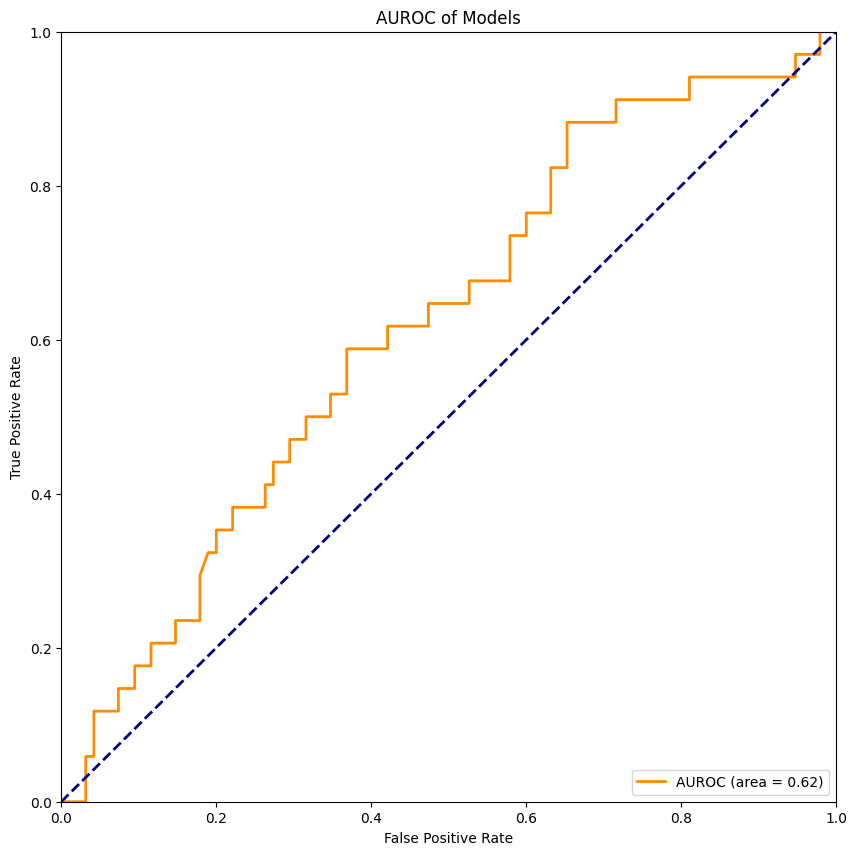

In [15]:
# kmer = 345, model = LR
#Construct Logistic Regression model
LR_perf = logistic_regression_classification(x_test=x_test, x_train=x_train,y_test=y_test,y_train=y_train, output_dir=output_dir)


*** SVM ***


<Figure size 640x480 with 0 Axes>

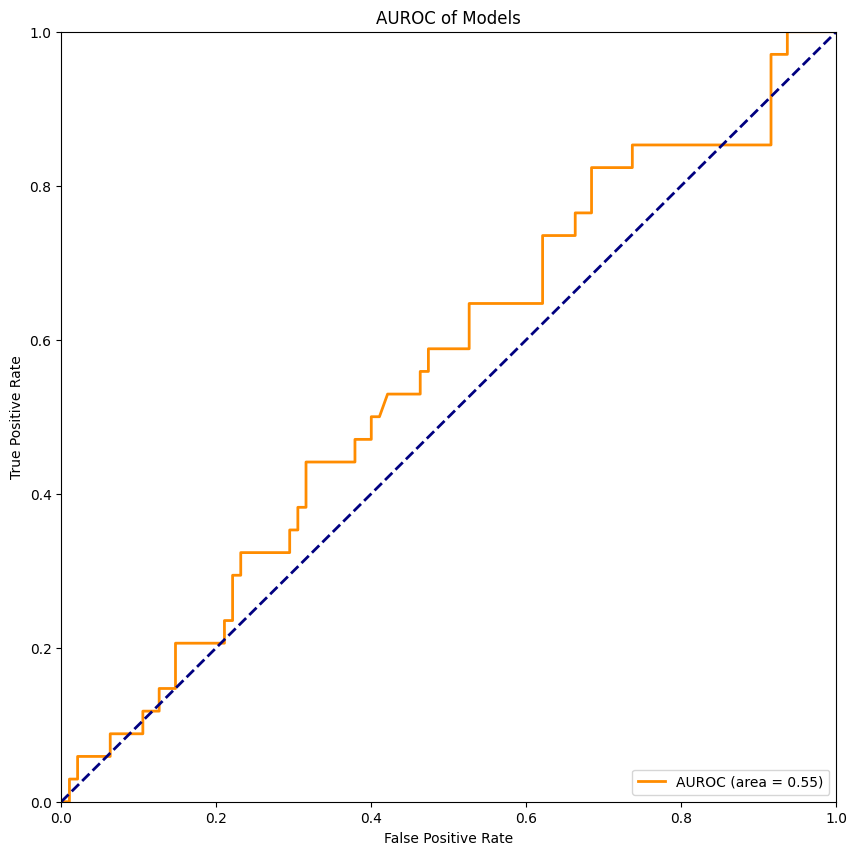

In [17]:
SVM_perf = SVM_classification(x_test=x_test, x_train=x_train,y_test=y_test,y_train=y_train, output_dir=output_dir)


*** Random Forest  ***


<Figure size 640x480 with 0 Axes>

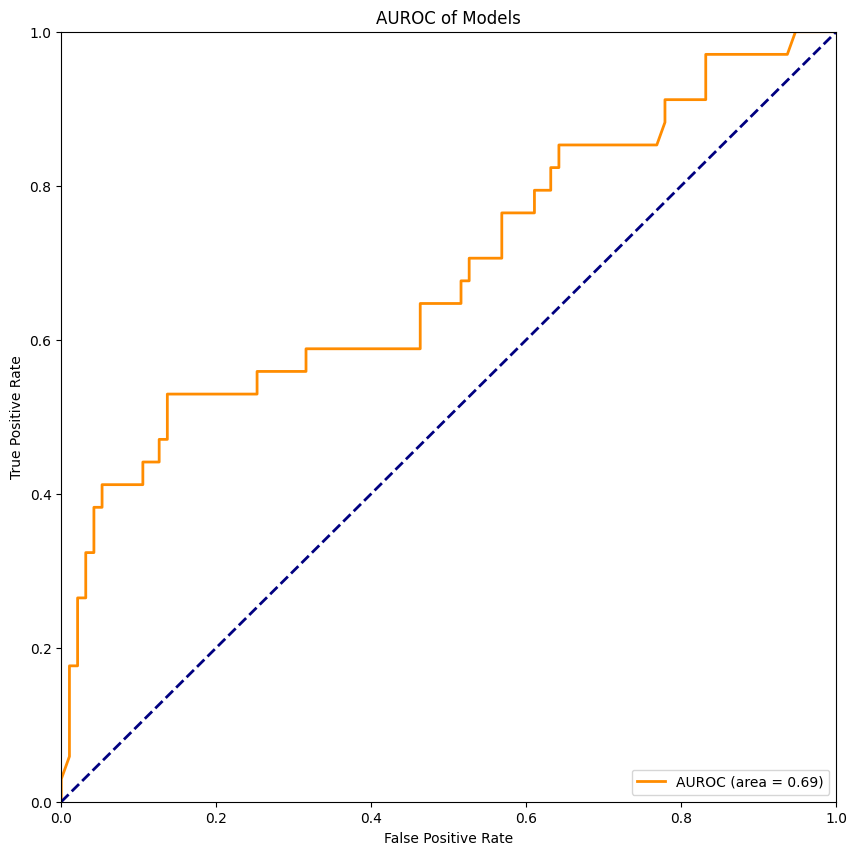

In [18]:
RF_perf = RF_classification(x_test=x_test, x_train=x_train,y_test=y_test,y_train=y_train, output_dir=output_dir)


*** LightGBM ***


[LightGBM] [Info] Number of positive: 281, number of negative: 648
[LightGBM] [Info] Number of positive: 280, number of negative: 648
[LightGBM] [Info] Number of positive: 280, number of negative: 648
[LightGBM] [Info] Number of positive: 280, number of negative: 648[LightGBM] [Info] Number of positive: 281, number of negative: 648

[LightGBM] [Info] Number of positive: 281, number of negative: 648
[LightGBM] [Info] Number of positive: 281, number of negative: 648
[LightGBM] [Info] Number of positive: 281, number of negative: 648[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.123323 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.097225 seconds.
You can set `force_col_wise=true` to remove the overhead.

[LightGBM] [Info] Total Bins 192914
[LightGBM] [Info] Total Bins 190307
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhe

<Figure size 640x480 with 0 Axes>

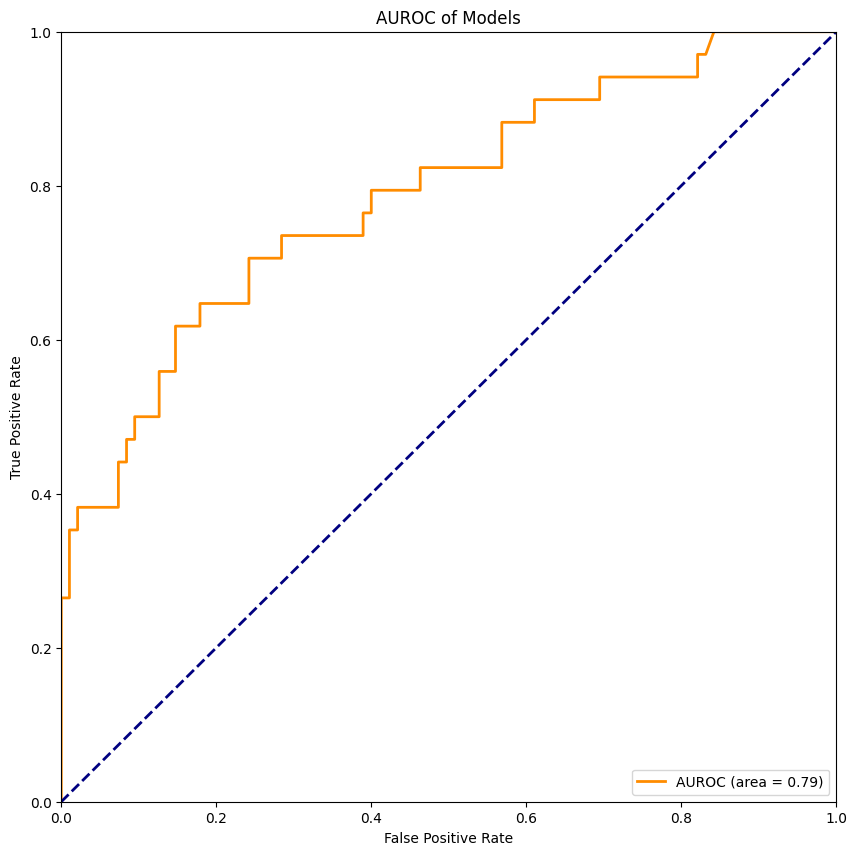

In [19]:
lightGBM_perf = lightGBM_classification(x_test=x_test, x_train=x_train,y_test=y_test,y_train=y_train, output_dir=output_dir)

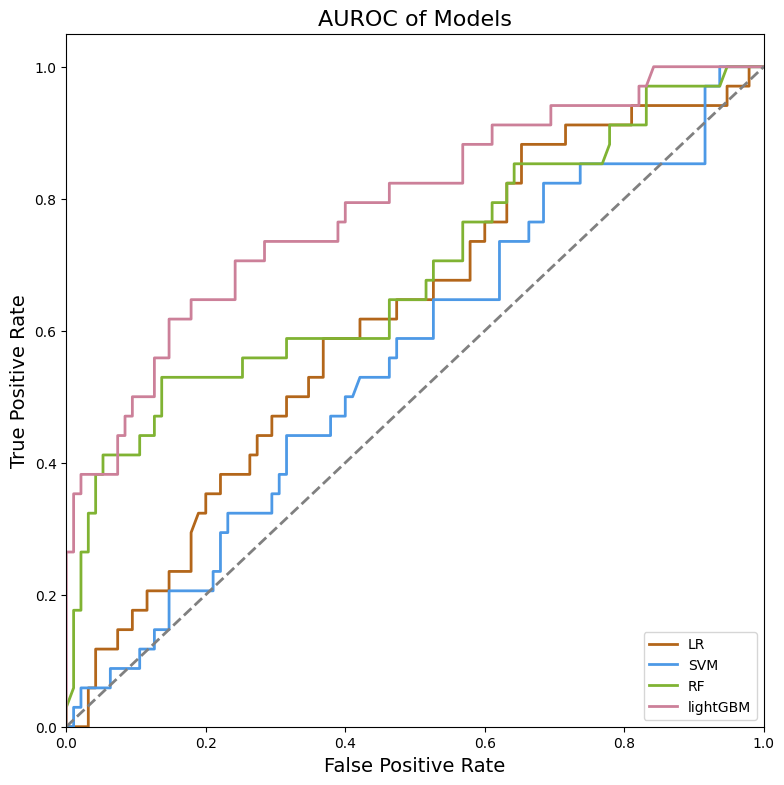

In [55]:
def plot_AUROC(LR_perf, SVM_perf, RF_perf, lightGBM_perf, path):
    # Prepare figure and line width
    plt.figure(figsize=(9, 9))
    lw = 2
    
    # Define colors with low saturation (RGB format)
    colors = {
        'LR': (0.7, 0.4, 0.1),  # RGB for LR (low saturation)
        'SVM': (0.3, 0.6, 0.9),  # RGB for SVM (low saturation)
        'RF': (0.5, 0.7, 0.2),   # RGB for RF (low saturation)
        'lightGBM': (0.8, 0.5, 0.6)  # RGB for lightGBM (low saturation)
    }
    
    # Function to plot a single model's AUROC
    def plot_single_roc(model_perf, label, color):
        roc_auc = model_perf["auroc"]
        fpr, tpr, _ = model_perf["auroc_curve"]
        plt.plot(fpr, tpr, color=color, lw=lw, label=f'{label}')
    
    # Plot AUROC for each model
    plot_single_roc(LR_perf, 'LR', colors['LR'])
    plot_single_roc(SVM_perf, 'SVM', colors['SVM'])
    plot_single_roc(RF_perf, 'RF', colors['RF'])
    plot_single_roc(lightGBM_perf, 'lightGBM', colors['lightGBM'])
    
    # Plot diagonal line (random classifier)
    plt.plot([0, 1], [0, 1], color='grey', lw=lw, linestyle='--')

    # Customize the plot
    plt.xlim([0.0, 1.0])
    plt.ylim([0.0, 1.05])
    plt.xlabel("False Positive Rate", fontsize=14)
    plt.ylabel("True Positive Rate", fontsize=14)
    plt.title("AUROC of Models", fontsize=16)
    plt.legend(loc="lower right")
    
    # Save the plot
    plt.savefig(os.path.join(path, "AUROC_Models.pdf"), format="pdf")
    plt.show()

plot_AUROC(LR_perf = LR_perf[1], SVM_perf = SVM_perf, RF_perf = RF_perf, lightGBM_perf = lightGBM_perf, path = './')


In [41]:
RF_perf

{'auroc': 0.6902476780185759,
 'auroc_curve': (array([0.        , 0.        , 0.01052632, 0.01052632, 0.02105263,
         0.02105263, 0.03157895, 0.03157895, 0.04210526, 0.04210526,
         0.05263158, 0.05263158, 0.07368421, 0.09473684, 0.10526316,
         0.10526316, 0.12631579, 0.12631579, 0.13684211, 0.13684211,
         0.15789474, 0.17894737, 0.25263158, 0.25263158, 0.31578947,
         0.31578947, 0.46315789, 0.46315789, 0.51578947, 0.51578947,
         0.52631579, 0.52631579, 0.56842105, 0.56842105, 0.61052632,
         0.61052632, 0.63157895, 0.63157895, 0.64210526, 0.64210526,
         0.68421053, 0.76842105, 0.77894737, 0.77894737, 0.8       ,
         0.83157895, 0.83157895, 0.93684211, 0.94736842, 1.        ]),
  array([0.        , 0.02941176, 0.05882353, 0.17647059, 0.17647059,
         0.26470588, 0.26470588, 0.32352941, 0.32352941, 0.38235294,
         0.38235294, 0.41176471, 0.41176471, 0.41176471, 0.41176471,
         0.44117647, 0.44117647, 0.47058824, 0.47058824,